In [1]:
import sys
sys.path.append("/scratch/mz2476/DL/project/")

In [2]:
import os
import random
import argparse

import numpy as np

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import kornia

from ssl_project.data_loaders.data_helper import LabeledDataset, FastLabeledRoadDataset, SegmentationDatasetAllImages
# from helper import compute_ats_bounding_boxes, compute_ts_road_map

# from model_loader import get_transform_task1, get_transform_task2, ModelLoader

import matplotlib.pyplot as plt
from ssl_project.data_loaders import plot_utils

from ssl_project.preprocessing import projections
import cv2

plt.rcParams["figure.figsize"] = (8, 8)


from importlib import reload
reload(plot_utils);

from ssl_project.constants import CAM_NAMES, CAM_ANGLE

In [3]:
from projecting import ProjectionToBEV
import projecting
reload(projecting)

<module 'projecting' from '/scratch/mz2476/DL/project/ssl_project/perspective_transform/projecting.py'>

In [4]:
data = FastLabeledRoadDataset(road_image_name="CARS_top_down_segm", scene_index=[106, 107])

In [5]:
photos_63hw, _, segm_WW, _ = data[20]

In [7]:
reload(projecting)
proj = projecting.ProjectionToBEV(alpha=70)


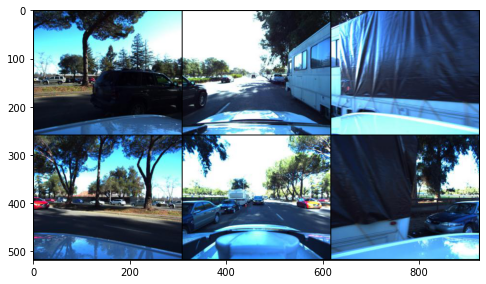

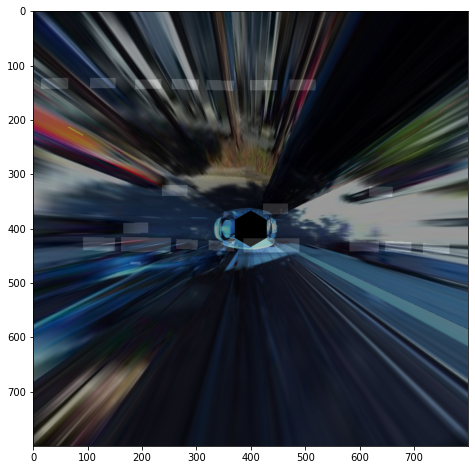

In [8]:

plot_utils.plot_photos(photos_63hw)

fig, axis = plt.subplots(1, 1)
plot_utils.plot_photos(proj.get_warped_3WW(photos_63hw, offset=5), axis=axis)
plot_utils.plot_photos(segm_WW * 100, axis=axis, alpha=0.4)

# fig, axis = plt.subplots(1, 1)
# plot_utils.plot_photos(get_warped_3WW(photos_63hw, True), axis=axis)
# plot_utils.plot_photos(segm_WW * 100, axis=axis, alpha=0.6)

In [107]:
from torchvision.utils import save_image
from joblib import Parallel, delayed

def create_warped_glued_photos(prefix="WARPED_3WW_", n_jobs=8, slc=slice(None), debug=False):
#     TMP = []
    
    def _save_warped(idx):
        labeled_trainset = LabeledDataset()
        scene_id, sample_id, path = labeled_trainset._get_ids_and_path(idx)
        photos_63hw = labeled_trainset._get_images(path)
#         print(photos_63hw.shape)
        warped_3WW = proj.get_warped_3WW(photos_63hw, offset=5)
#         print(f"{path}/{prefix}top_down_segm.png")
        save_image(warped_3WW, f"{path}/{prefix}top_down_segm.png")
#         TMP.append((idx, f"{path}/{prefix}top_down_segm.png"))

    labeled_trainset = LabeledDataset()

    if debug:
        for idx in range(len(labeled_trainset))[slc]:
            _save_warped(idx)
    else:
        Parallel(n_jobs=n_jobs)(
            delayed(_save_warped)(idx) 
            for idx in range(len(labeled_trainset))[slc]
        )
        
#     return TMP

In [108]:
create_warped_glued_photos()

In [97]:
# idx=TMP[3][0]
# for photo_idx in range(6):
#     fig, axis= plt.subplots(1, 1)
#     plot_utils.plot_photos(labeled_trainset[idx][0][photo_idx], axis=axis)
#     axis.axhline(256/2 + 10, c='r')

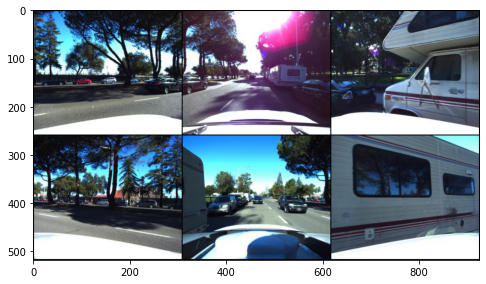

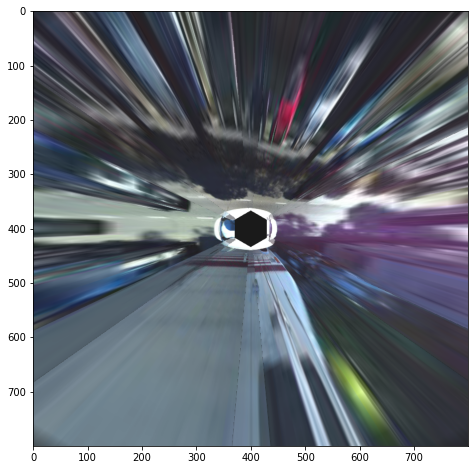

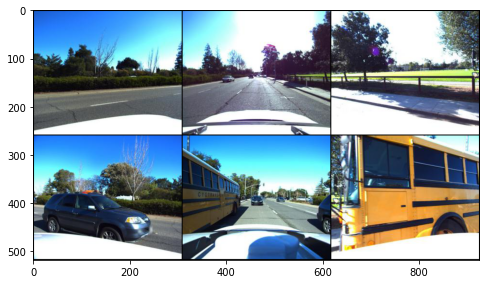

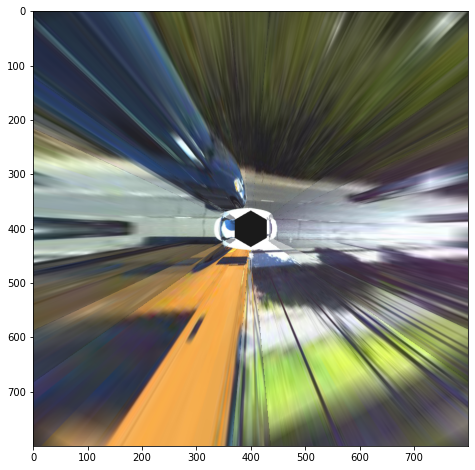

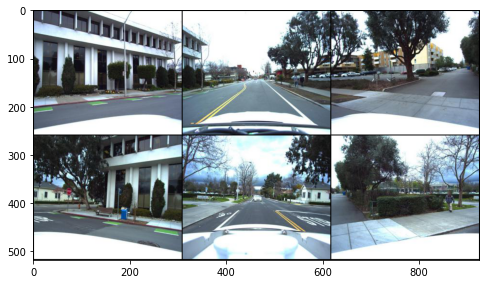

...

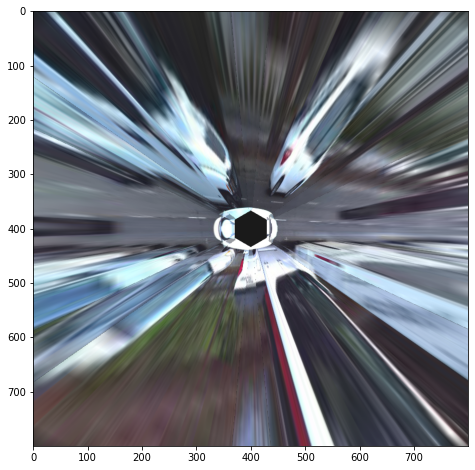

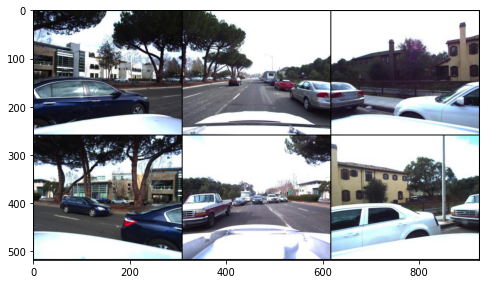

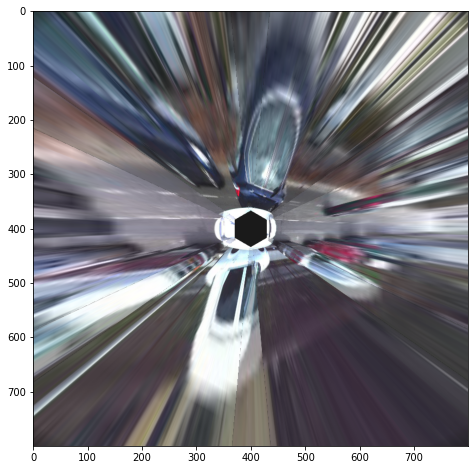

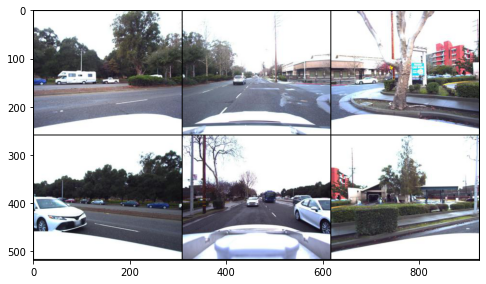

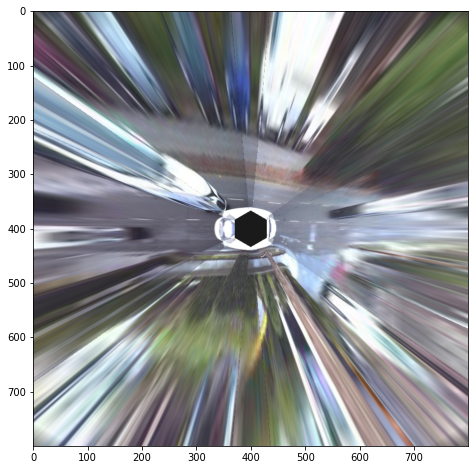

In [106]:
for idx, path_to_warp in TMP:
    plot_utils.plot_photos(labeled_trainset[idx][0])
    warped_image = Image.open(path_to_warp)
#     semg_image = Image.open(f"{path_to_warp.rsplit('/', 1)[0]}/CARS_top_down_segm.png")
#     road_image = Image.open(f"{path_to_warp.rsplit('/', 1)[0]}/ROAD_top_down_segm.png")
    
    plt.show()
#     plt.imshow(semg_image)#, alpha=0.3)
#     plt.imshow(road_image)#, alpha=0.3)
    plt.imshow(warped_image, alpha=0.9)
    plt.show()


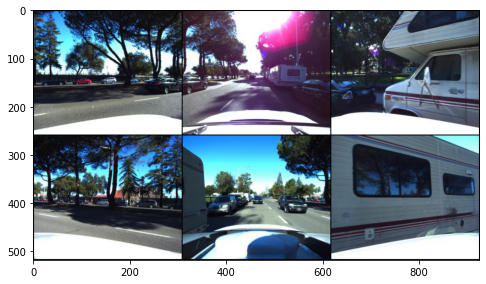

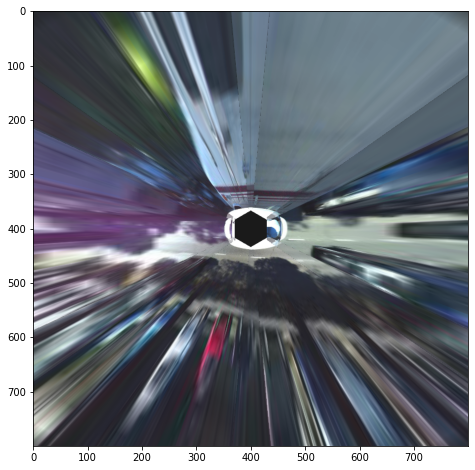

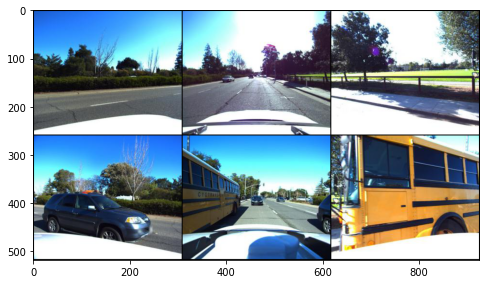

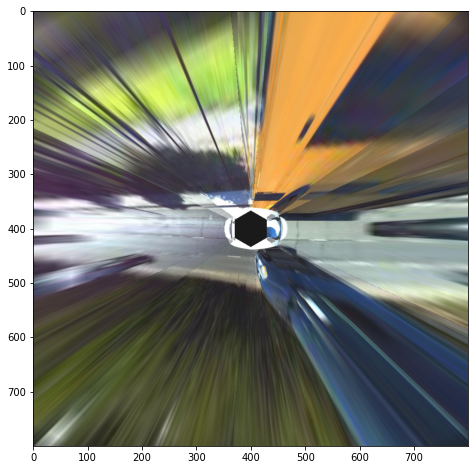

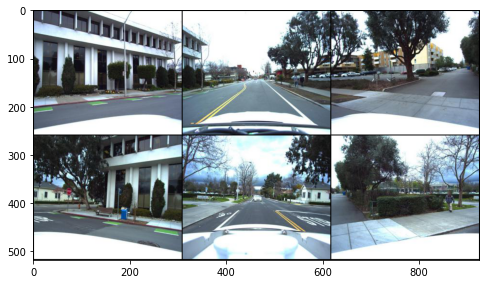

...

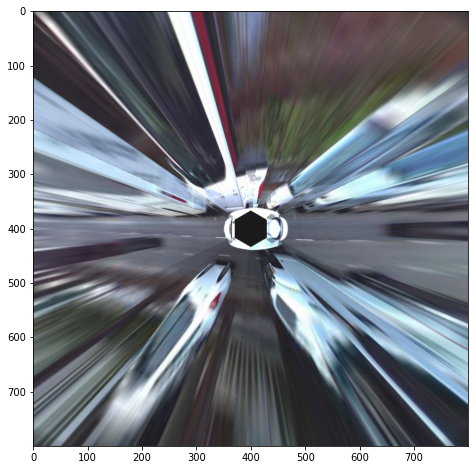

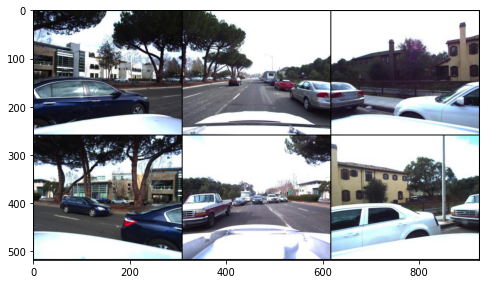

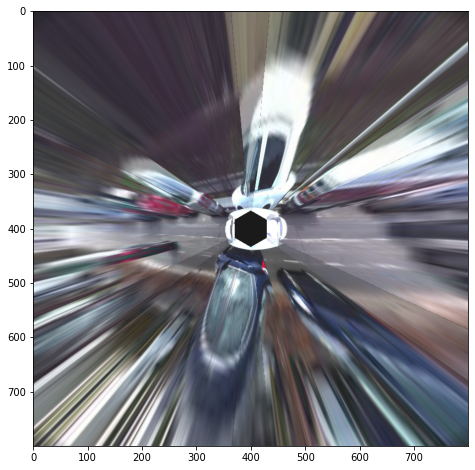

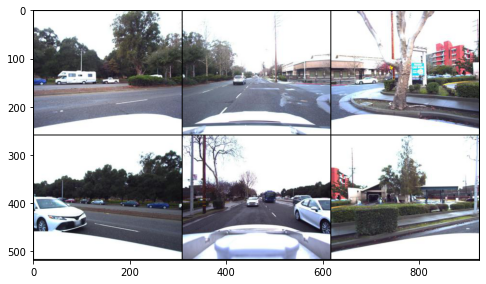

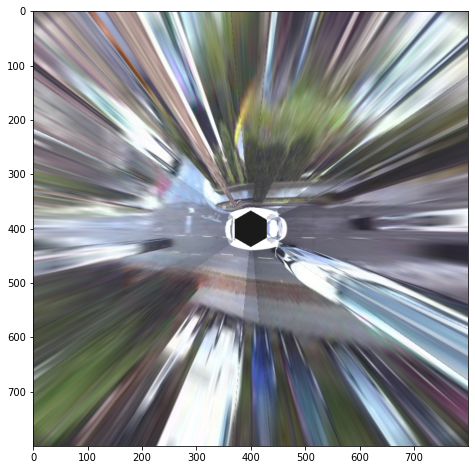

In [86]:
for idx, path_to_warp in TMP:
    plot_utils.plot_photos(labeled_trainset[idx][0])
    warped_image = Image.open(path_to_warp)
#     semg_image = Image.open(f"{path_to_warp.rsplit('/', 1)[0]}/CARS_top_down_segm.png")
#     road_image = Image.open(f"{path_to_warp.rsplit('/', 1)[0]}/ROAD_top_down_segm.png")
    
    plt.show()
#     plt.imshow(semg_image)#, alpha=0.3)
#     plt.imshow(road_image)#, alpha=0.3)
    plt.imshow(warped_image, alpha=0.9)
    plt.show()


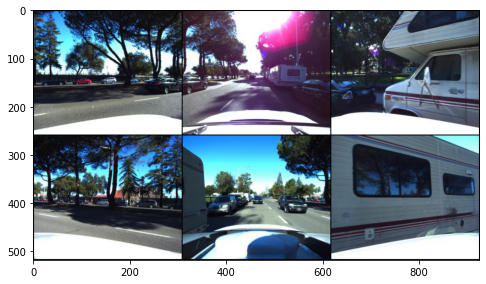

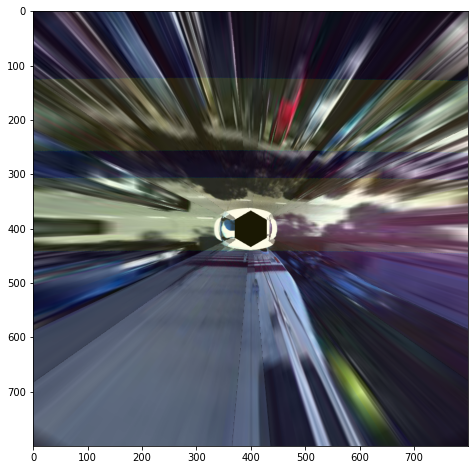

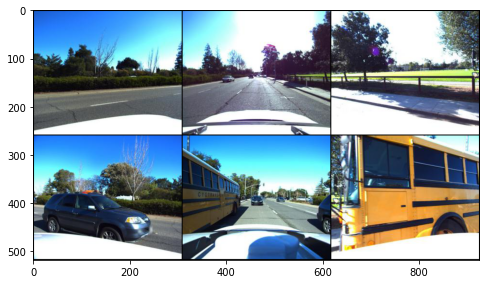

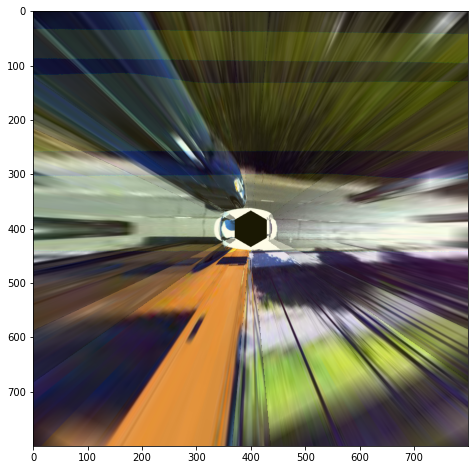

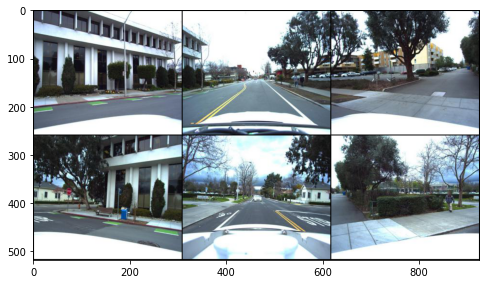

...

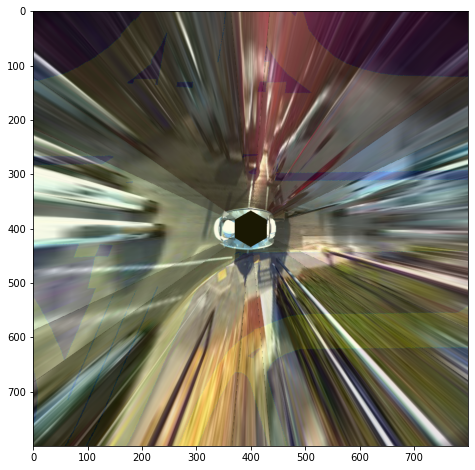

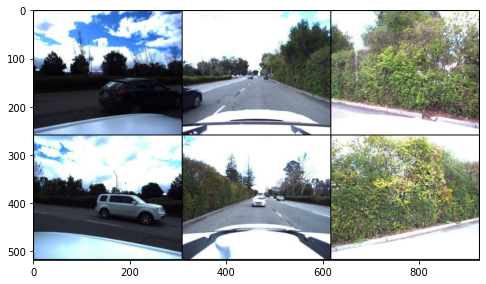

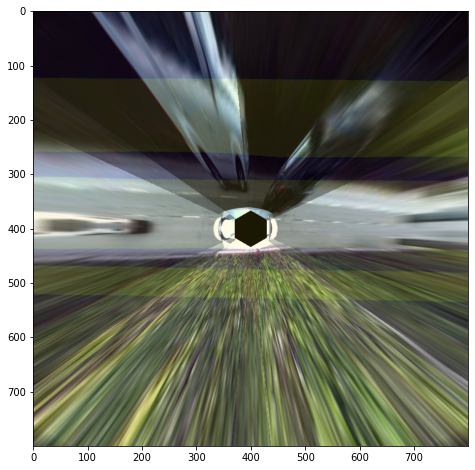

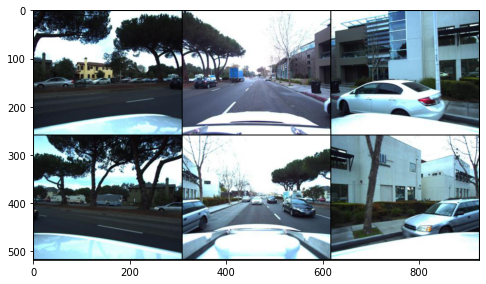

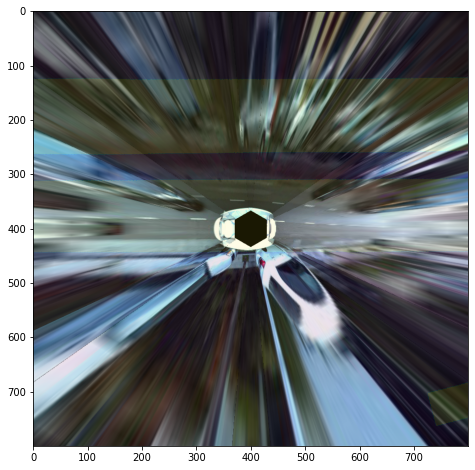

In [40]:
for idx, path_to_warp in TMP:
    plot_utils.plot_photos(labeled_trainset[idx][0])
    warped_image = Image.open(path_to_warp)
    semg_image = Image.open(f"{path_to_warp.rsplit('/', 1)[0]}/CARS_top_down_segm.png")
    road_image = Image.open(f"{path_to_warp.rsplit('/', 1)[0]}/ROAD_top_down_segm.png")
    
    plt.show()
    plt.imshow(semg_image)#, alpha=0.3)
    plt.imshow(road_image)#, alpha=0.3)
    plt.imshow(warped_image, alpha=0.9)
    plt.show()


In [ ]:
for img in labeled_trainset

In [ ]:
path = "/scratch/mz2476/DL/project/ssl_project/data/"

In [10]:
image = Image.open("/scratch/mz2476/DL/project/ssl_project/data/scene_106/sample_1/WARPED_3WW_top_down_segm.png")

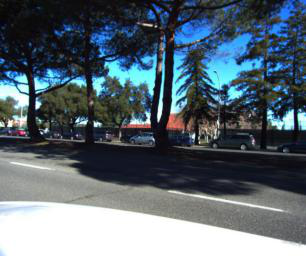

In [22]:
Image.open("/scratch/mz2476/DL/project/ssl_project/data/scene_106/sample_1/CAM_BACK_LEFT.jpeg")
 

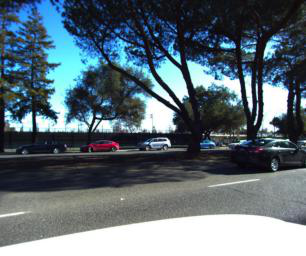

In [23]:
 Image.open("/scratch/mz2476/DL/project/ssl_project/data/scene_106/sample_1/CAM_FRONT_LEFT.jpeg")

In [13]:
map_BEV = Image.open("/scratch/mz2476/DL/project/ssl_project/data/scene_106/sample_1/top_down_segm.png")

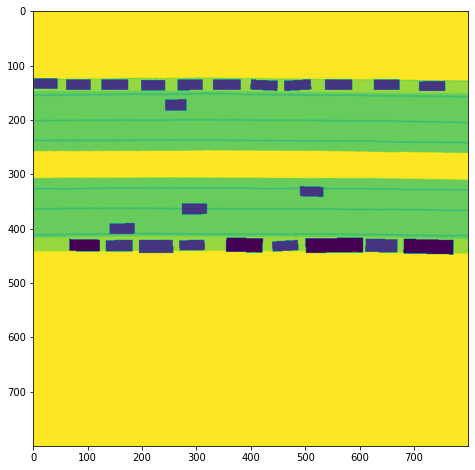

In [16]:
plt.imshow(map_BEV)

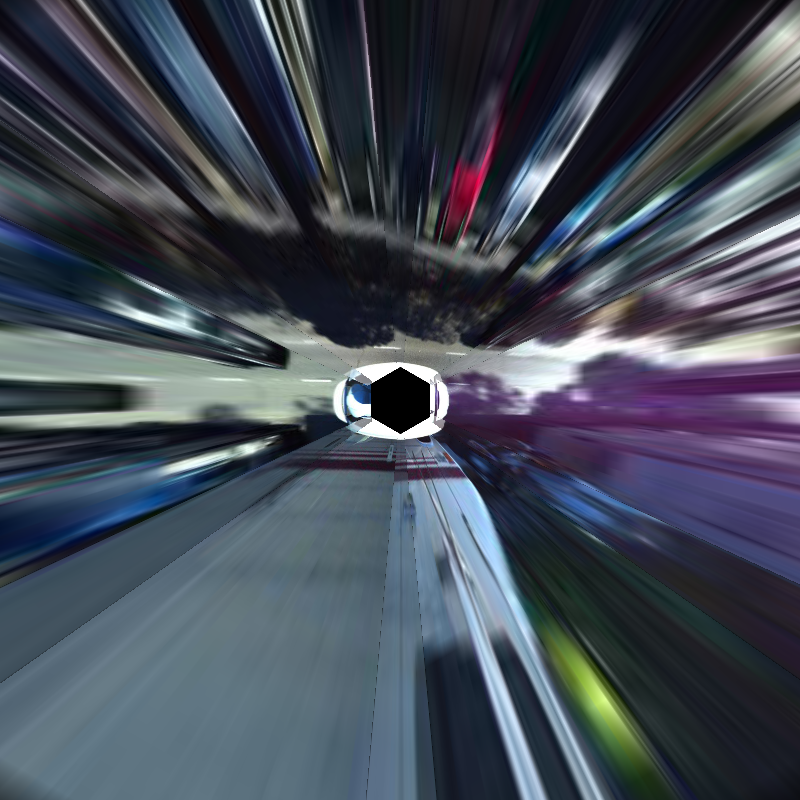

In [12]:
image

TypeError: tensor or list of tensors expected, got <class 'PIL.PngImagePlugin.PngImageFile'>

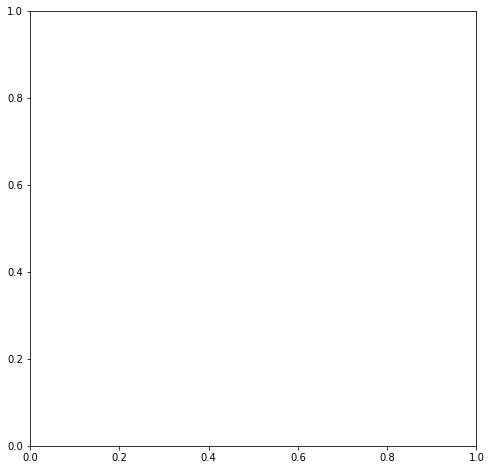

In [11]:
plot_utils.plot_photos(image)

In [ ]:
# def create_warped_glued_photos(prefix="WARPED_3WW_", n_jobs=8, slc=slice(None), debug=False):
#     def _save_road_mask(idx):
#         scene_id, sample_id, path = labeled_trainset._get_ids_and_path(idx)
#         target, road_image, ego_image, data_entries = labeled_trainset._get_target_road_ego_image(scene_id, sample_id, path)

#         cv2.imwrite(f"{path}/{prefix}top_down_segm.png", to_np(road_image).astype(int))

#     labeled_trainset = LabeledDataset()
    
#     if debug:
#         for idx in range(len(labeled_trainset))[slc]:
#             _save_road_mask(idx)
#     else:
#         Parallel(n_jobs=n_jobs)(
#             delayed(_save_road_mask)(idx) 
#             for idx in range(len(labeled_trainset))[slc]
#         )

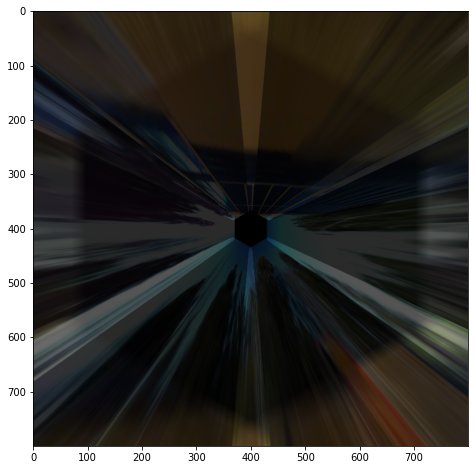

In [80]:
plot_utils.plot_photos(img_warp_63WW.mean(0))


In [45]:
%debug


> /scratch/mz2476/miniconda3/envs/pDL/lib/python3.8/site-packages/kornia/geometry/transform/imgwarp.py(82)warp_perspective()
     80 
     81     if not len(src.shape) == 4:
---> 82         raise ValueError("Input src must be a BxCxHxW tensor. Got {}"
     83                          .format(src.shape))
     84 

ipdb> q


In [16]:
M = cv2.getPerspectiveTransform(points_src, points_tgt)

In [17]:
points_src

array([[  0., 256.],
       [306., 256.],
       [  0., 137.],
       [306., 137.]], dtype=float32)

In [33]:
img_warp.shape

torch.Size([3, 800, 800])

In [30]:
img_warp_3WW = kornia.warp_perspective(clip_photo(photos_63hw[1, :, :][None]), 
                                       torch.Tensor(M), dsize=(800, 800))[0]
# img_warp[:, :, :400]= 0

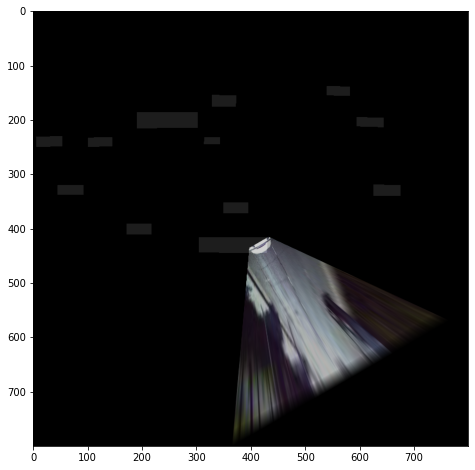

In [60]:
fig, axis = plt.subplots(1, 1)
plot_utils.plot_photos(img_warp, axis=axis)
plot_utils.plot_photos(segm_WW * 100, axis=axis, alpha=0.3)

In [151]:
segm_WW.shape

torch.Size([1, 800, 800])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
